# S3E26 EDA

# Imports

In [1]:
import numpy as np
import pandas as pd

pd.set_option('display.max_columns', 50)

import matplotlib.pyplot as plt
#import plotly.express as px
import seaborn as sns

sns.set_style('whitegrid')

import warnings

warnings.filterwarnings("ignore")

# Config

In [2]:
class Config():
    seed = 12
    folds = 5
    
config = Config()

# Load Data

In [4]:
kaggle = False

if kaggle:
    root_dir = '/kaggle/input/playground-series-s3e26'
else:
    root_dir = '.'

train = pd.read_csv(root_dir + '/train.csv')
test = pd.read_csv(root_dir + '/test.csv')
ss = pd.read_csv(root_dir + '/sample_submission.csv')

## Original Data

In [7]:
add_orig = True

if add_orig:

    orig = pd.read_csv(root_dir + '/cirrhosis.csv')
    orig = orig.rename(columns={"ID":"id"})

    # lots have nearly all floats nan (106 count)
    orig = orig.dropna(subset=['Drug'])

    # Cholesterol are both na in 28, and only tryglicerides in 30, maybe drop both for now.  Could impute this later
    orig = orig.dropna(subset=['Tryglicerides'])

    # # copper has 2 na's and Platelets have 4 - fill with mean, maybe smarter imputation later
    # orig.Copper = orig.Copper.fillna(orig.Copper.mean())
    # orig.Platelets = orig.Platelets.fillna(orig.Platelets.mean())

    # just drop these instead of filling with mean - there are only a few of these...
    orig = orig.dropna(subset=['Copper'])
    orig = orig.dropna(subset=['Platelets'])

    train = pd.concat([train,orig])
    train.shape


In [8]:
train.head()

,id,N_Days,Drug,Age,Sex,Ascites,Hepatomegaly,Spiders,Edema,Bilirubin,Cholesterol,Albumin,Copper,Alk_Phos,SGOT,Tryglicerides,Platelets,Prothrombin,Stage,Status
0,0,999,D-penicillamine,21532,M,N,N,N,N,2.3,316.0,3.35,172.0,1601.0,179.80,63.0,394.0,9.7,3.0,D
1,1,2574,Placebo,19237,F,N,N,N,N,0.9,364.0,3.54,63.0,1440.0,134.85,88.0,361.0,11.0,3.0,C
2,2,3428,Placebo,13727,F,N,Y,Y,Y,3.3,299.0,3.55,131.0,1029.0,119.35,50.0,199.0,11.7,4.0,D
3,3,2576,Placebo,18460,F,N,N,N,N,0.6,256.0,3.50,58.0,1653.0,71.30,96.0,269.0,10.7,3.0,C
4,4,788,Placebo,16658,F,N,Y,N,N,1.1,346.0,3.65,63.0,1181.0,125.55,96.0,298.0,10.6,4.0,C


# Top Level Stats

In [9]:
# print all sets
print(f'Training Data Shape: {train.shape}')
display(train.head())
print(f'Test Data Shape: {test.shape}')
display(test.head())
print(f'Sample Submission Shape: {ss.shape}')
display(ss.head())

Training Data Shape: (8181, 20)


,id,N_Days,Drug,Age,Sex,Ascites,Hepatomegaly,Spiders,Edema,Bilirubin,Cholesterol,Albumin,Copper,Alk_Phos,SGOT,Tryglicerides,Platelets,Prothrombin,Stage,Status
0,0,999,D-penicillamine,21532,M,N,N,N,N,2.3,316.0,3.35,172.0,1601.0,179.80,63.0,394.0,9.7,3.0,D
1,1,2574,Placebo,19237,F,N,N,N,N,0.9,364.0,3.54,63.0,1440.0,134.85,88.0,361.0,11.0,3.0,C
2,2,3428,Placebo,13727,F,N,Y,Y,Y,3.3,299.0,3.55,131.0,1029.0,119.35,50.0,199.0,11.7,4.0,D
3,3,2576,Placebo,18460,F,N,N,N,N,0.6,256.0,3.50,58.0,1653.0,71.30,96.0,269.0,10.7,3.0,C
4,4,788,Placebo,16658,F,N,Y,N,N,1.1,346.0,3.65,63.0,1181.0,125.55,96.0,298.0,10.6,4.0,C


Test Data Shape: (5271, 19)


,id,N_Days,Drug,Age,Sex,Ascites,Hepatomegaly,Spiders,Edema,Bilirubin,Cholesterol,Albumin,Copper,Alk_Phos,SGOT,Tryglicerides,Platelets,Prothrombin,Stage
0,7905,3839,D-penicillamine,19724,F,N,Y,N,N,1.2,546.0,3.37,65.0,1636.0,151.90,90.0,430.0,10.6,2.0
1,7906,2468,D-penicillamine,14975,F,N,N,N,N,1.1,660.0,4.22,94.0,1257.0,151.90,155.0,227.0,10.0,2.0
2,7907,51,Placebo,13149,F,N,Y,N,Y,2.0,151.0,2.96,46.0,961.0,69.75,101.0,213.0,13.0,4.0
3,7908,2330,D-penicillamine,20510,F,N,N,N,N,0.6,293.0,3.85,40.0,554.0,125.55,56.0,270.0,10.6,2.0
4,7909,1615,D-penicillamine,21904,F,N,Y,N,N,1.4,277.0,2.97,121.0,1110.0,125.00,126.0,221.0,9.8,1.0


Sample Submission Shape: (5271, 4)


,id,Status_C,Status_CL,Status_D
0,7905,0.628084,0.034788,0.337128
1,7906,0.628084,0.034788,0.337128
2,7907,0.628084,0.034788,0.337128
3,7908,0.628084,0.034788,0.337128
4,7909,0.628084,0.034788,0.337128


In [10]:
display(train.describe())  #.style.background_gradient(cmap='Blues'))
display(test.describe())  #.style.background_gradient(cmap='Blues'))

,id,N_Days,Age,Bilirubin,Cholesterol,Albumin,Copper,Alk_Phos,SGOT,Tryglicerides,Platelets,Prothrombin,Stage
count,8181.000000,8181.000000,8181.000000,8181.000000,8181.000000,8181.000000,8181.000000,8181.000000,8181.000000,8181.000000,8181.000000,8181.000000,8181.000000
mean,3824.023713,2028.452512,18366.944994,2.619423,351.260237,3.547260,84.471825,1822.813348,114.925595,115.665322,265.112333,10.633040,3.032759
std,2345.586861,1094.820580,3685.501456,3.844169,196.856060,0.348327,76.403770,1911.409689,49.105416,53.034271,87.658802,0.790593,0.866041
min,0.000000,41.000000,9598.000000,0.300000,120.000000,1.960000,4.000000,289.000000,26.350000,33.000000,62.000000,9.000000,1.000000
25%,1769.000000,1230.000000,15574.000000,0.700000,248.000000,3.350000,39.000000,834.000000,75.950000,84.000000,210.000000,10.000000,2.000000
50%,3814.000000,1831.000000,18701.000000,1.100000,299.000000,3.580000,63.000000,1181.000000,108.500000,104.000000,265.000000,10.600000,3.000000
75%,5859.000000,2689.000000,20684.000000,3.000000,392.000000,3.770000,102.000000,1857.000000,137.950000,139.000000,316.000000,11.000000,4.000000
max,7904.000000,4795.000000,28650.000000,28.000000,1775.000000,4.640000,588.000000,13862.400000,457.250000,598.000000,563.000000,18.000000,4.000000


,id,N_Days,Age,Bilirubin,Cholesterol,Albumin,Copper,Alk_Phos,SGOT,Tryglicerides,Platelets,Prothrombin,Stage
count,5271.000000,5271.000000,5271.000000,5271.000000,5271.000000,5271.000000,5271.000000,5271.000000,5271.000000,5271.000000,5271.000000,5271.000000,5271.000000
mean,10540.000000,2038.696642,18497.756782,2.600389,352.486435,3.538071,84.701679,1811.233314,113.587526,115.286094,264.023715,10.632865,3.036995
std,1521.750965,1086.843490,3583.898801,3.852395,200.438989,0.354886,77.542064,1935.351492,48.964789,52.602780,87.584068,0.792711,0.856030
min,7905.000000,41.000000,9598.000000,0.300000,120.000000,1.960000,4.000000,289.000000,26.350000,33.000000,62.000000,9.000000,1.000000
25%,9222.500000,1234.000000,15730.000000,0.700000,248.000000,3.350000,39.000000,823.000000,75.000000,84.000000,209.000000,10.000000,2.000000
50%,10540.000000,1882.000000,18806.000000,1.100000,299.000000,3.570000,65.000000,1142.000000,106.950000,104.000000,259.000000,10.600000,3.000000
75%,11857.500000,2692.000000,20684.000000,3.000000,390.000000,3.770000,102.000000,1838.500000,137.950000,138.000000,317.000000,11.000000,4.000000
max,13175.000000,4795.000000,28650.000000,28.000000,1775.000000,4.640000,588.000000,13862.400000,457.250000,598.000000,563.000000,15.200000,4.000000


<b>Takeaways</b>
* Small Dataset
    * Train has only 7905 training records
    * Test has 5271
* Stats look pretty close between train and test
    * should write a function to compare percent difference
* Repeated kfolds may work well

In [11]:
def df_summary_missing_counts(df):
    summary = pd.DataFrame(df.dtypes, columns=['dtype'])
    summary['Num missing'] = df.isna().sum()
    summary['Pct missing'] = (df.isna().sum()) / len(df)
    summary['Unique values'] = df.nunique().values
    summary['Count'] = df.count().values
    return summary

df_summary_missing_counts(train)  #.style.background_gradient(cmap='Blues')

,dtype,Num missing,Pct missing,Unique values,Count
id,int64,0,0.0,7905,8181
N_Days,int64,0,0.0,461,8181
Drug,object,0,0.0,2,8181
Age,int64,0,0.0,391,8181
Sex,object,0,0.0,2,8181
Ascites,object,0,0.0,2,8181
Hepatomegaly,object,0,0.0,2,8181
Spiders,object,0,0.0,2,8181
Edema,object,0,0.0,3,8181
Bilirubin,float64,0,0.0,111,8181


<b>Takeaways</b>
* No missing data to impute
* Highest unique values aside from id is 461, so they all seem to be somewhat discrete
* Binary cols:
    * Drug (placebo/penicil), Sex (M/F), Ascites (Y/N), Hepatomegaly (Y/N), Spiders (Y/N)
* Three uniques:
    * Edema (Y/N/S), Status (C/D/CL): This is the target
* Four uniques: 
    * Stage: (1.0,2.0,3.0,4.0): This shouldn't be a float
* The rest are float cols with 49-461 unique values

<b>Questions</b>
* What is up with age?
    * Guessing this is days since max is 28650/365, which is 78.x years, and min is 9598, which is 26.x years
    

* Endcode binaries as a bool, one-hot encode, or as something like an int8. Is there any advantages/disadvantages in terms of algorithm efficiency?
    
    * Answer: depends on model, will try a few different techniques. 


# EDA

## Distributions of Float Columns

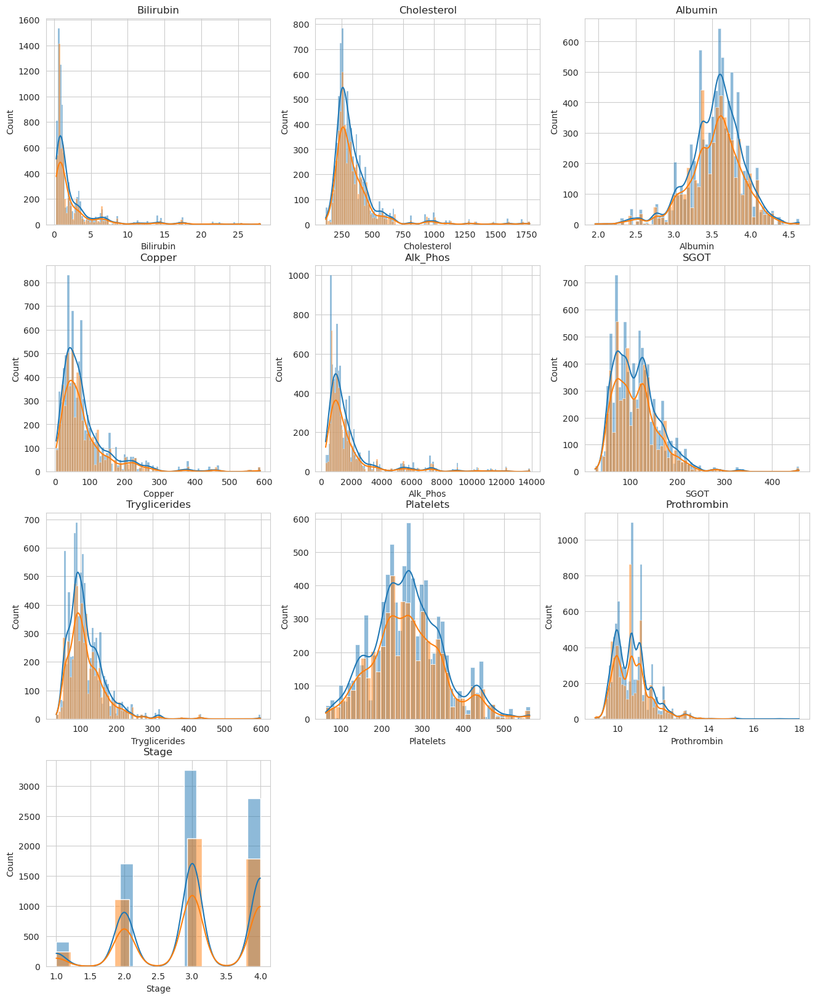

In [12]:
features = [col for col in train.columns if train[col].dtype == 'float']
rows = int(np.ceil(len(features) / 3))
plt.figure(figsize=(16, 5 * rows))
for i, col in enumerate(features):
    plt.subplot(rows, 3, i + 1)
    sns.histplot(train[col], kde=True)
    sns.histplot(test[col], kde=True)
    plt.title(col)


<b>Takeaways</b>
* Some features are skewed distributions
    * Try log transform

In [13]:
# features = [col for col in train.columns if train[col].dtype=='float']
# rows = int(np.ceil(len(features)/3)) 
# plt.figure(figsize=(16,5*rows)) 
# for i,col in enumerate(features): 
#   plt.subplot(rows,3,i+1) 
#   sns.violinplot(train[col],kde=True,hue=train.Status) 
# 
#   plt.title(col)

## Target Distribtion

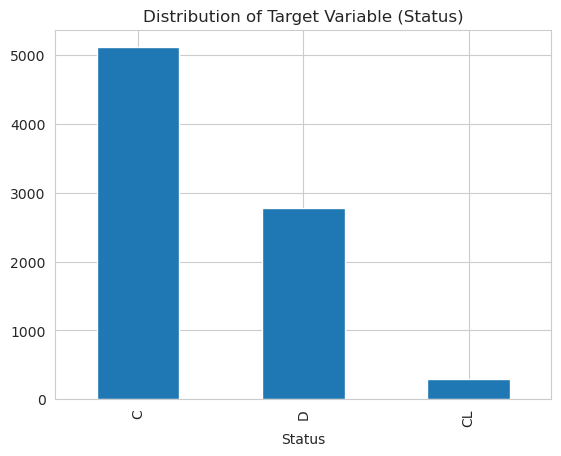

In [14]:
train.Status.value_counts().plot(kind='bar')
plt.title('Distribution of Target Variable (Status)')
plt.show()

<b>Takeaways</b>
* Imbalanced target classes means use stratified kfold 

## Drug Distribution

<Axes: xlabel='Drug'>

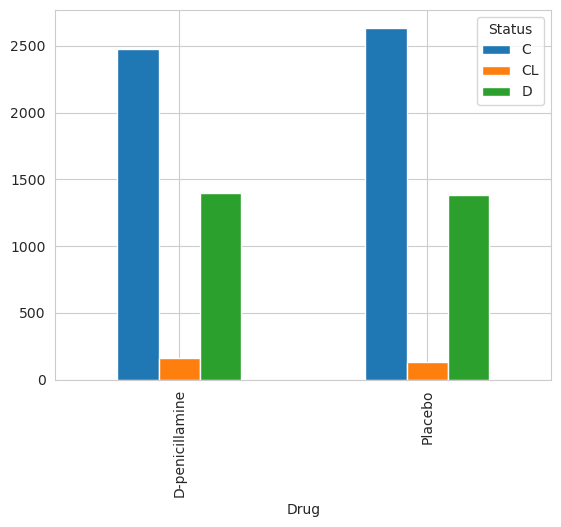

In [15]:
train.groupby(['Drug', 'Status']).size().unstack().plot(kind='bar', stacked=False)

## Sex Distribution

<Axes: xlabel='Sex'>

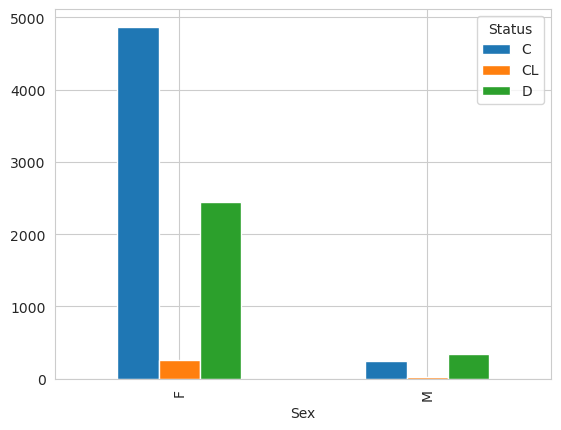

In [16]:
train.groupby(['Sex', 'Status']).size().unstack().plot(kind='bar', stacked=False)

<b>Takeaways</b>
* There are way more females in this study than males
* The ratio of C to D is much higher in females

## Spiders Distribution

<Axes: xlabel='Spiders'>

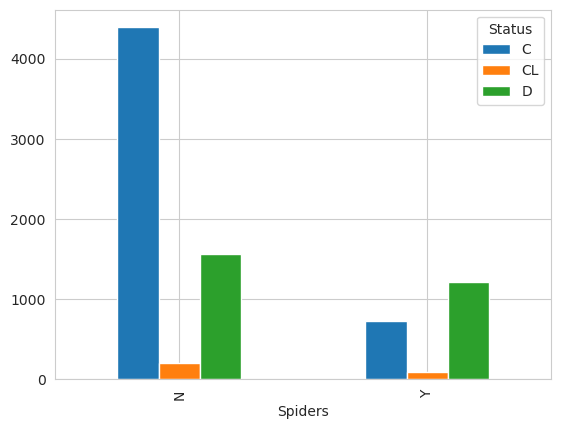

In [17]:
# groupby Spiders and status to see if there is a relationship
train.groupby(['Spiders', 'Status']).size().unstack().plot(kind='bar', stacked=False)

<b>Takeaways</b>
* Ratio of class 'C' is much higher if spiders are not present

## Ascites Distribution

<Axes: xlabel='Ascites'>

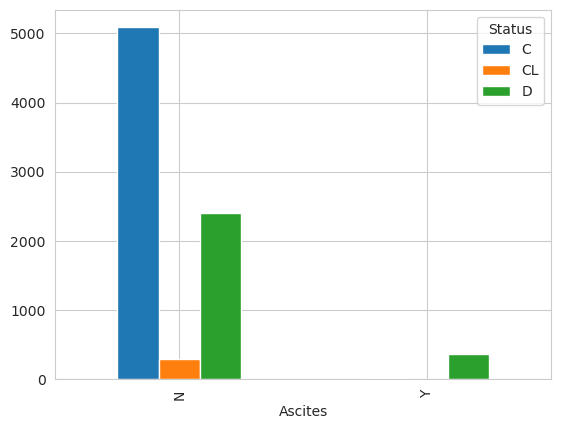

In [18]:
# groupby Ascites and status to see if there is a relationship
train.groupby(['Ascites', 'Status']).size().unstack().plot(kind='bar', stacked=False)

In [19]:
train.Ascites.value_counts()

Ascites
N    7782
Y     399
Name: count, dtype: int64

<b>Takeaways</b>
* Very few 'Y' values for Ascites
* Ratio of class 'C' is much higher if Ascites is not present

## Hepatomegaly Distribution

<Axes: xlabel='Hepatomegaly'>

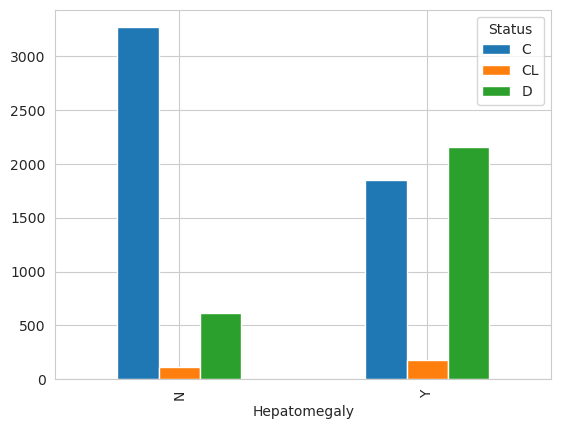

In [20]:
# groupby Hepatomegaly and status to see if there is a relationship
train.groupby(['Hepatomegaly', 'Status']).size().unstack().plot(kind='bar', stacked=False)

<b>Takeaways</b>
* Hepatomegaly value of 'N' has a much higher proportion of 'C' values

## Edema Distribution

<Axes: xlabel='Edema'>

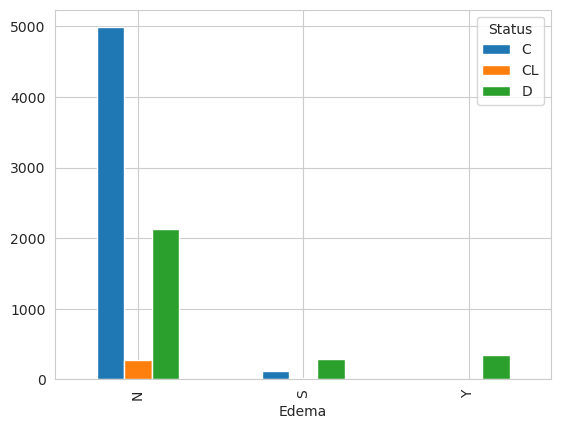

In [21]:
train.groupby(['Edema', 'Status']).size().unstack().plot(kind='bar', stacked=False)

In [22]:
train.Edema.value_counts()

Edema
N    7395
S     424
Y     362
Name: count, dtype: int64

<b>Takeaways</b>
* Most common value is 'N' by a long shot
* Edema value of 'N' has a much higher proportion of 'C' values


# Data Type Conversions
* So, to make binary columns booleans, int8's, or define as categorical?
    * Good opportunity to test this.
    


In [23]:
# binary columns (Drug, Sex, Ascites, Hepatomegaly, Spiders) should be a bool type, 
# edema and stage should be an int8

def convert_dtypes(df):
    df.Drug = df.Drug.astype('bool')
    df.Sex = df.Sex.astype('bool')
    df.Ascites = df.Ascites.astype('bool')
    df.Hepatomegaly = df.Hepatomegaly.astype('bool')
    df.Spiders = df.Spiders.astype('bool')
    df.Stage = df.Stage.astype('int8')
    #df.Edema= df.Edema.astype('category')
    # map edema to 0,1,2
    df.Edema = df.Edema.map({'N':0, 'S':1, 'Y':2})
    df.Edema = df.Edema.astype('int8')
    return df

train = convert_dtypes(train)
test = convert_dtypes(test)

In [24]:
# map target to 0,1,2, as an int8
train.Status = train.Status.map({'C':0,'CL':1, 'D':2})
train.Status = train.Status.astype('int8')


# Correlations

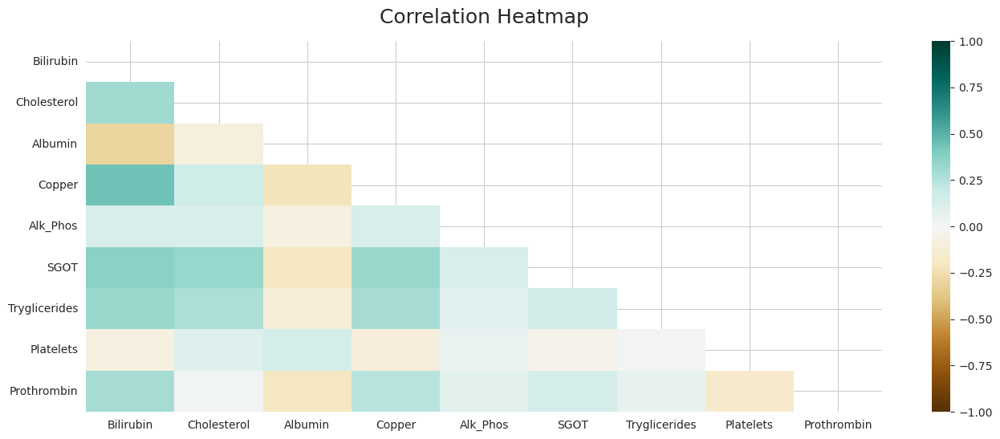

In [27]:
plt.figure(figsize=(16, 6))
float_feats = [col for col in train.columns if train[col].dtype == 'float']
mask = np.triu(np.ones_like(train[float_feats].corr(), dtype=bool))
heatmap = sns.heatmap(train[float_feats].corr(), mask=mask, vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize': 18}, pad=16);

## Correlation with Target

In [28]:
# plt.figure(figsize=(8, 12))  # set size by num of features 
# heatmap = sns.heatmap(train[float_feats].corr()[['Status']].sort_values(by='Status', ascending=False), vmin=-1,
#                       vmax=1, annot=True, cmap='BrBG')
# heatmap.set_title('Features Correlating with Target', fontdict={'fontsize': 18}, pad=16);

# Scaling
* Didn't help CV

In [29]:
# from sklearn.preprocessing import StandardScaler

# scaler = StandardScaler()
# train[float_feats] = scaler.fit_transform(train[float_feats])
# test[float_feats] = scaler.transform(test[float_feats])

# Log Transform
* Didn't help CV

In [30]:
# train[float_feats] = np.log1p(train[float_feats])
# test[float_feats] = np.log1p(test[float_feats])

# Cross Validation

In [31]:
from sklearn.model_selection import StratifiedKFold

def run_cv_and_predict(train, test, features, model, seed, verbose=True):
    
    # initialize arrays 
    fold_scores = []
    oof = np.zeros((train.shape[0],3))
    preds = np.zeros((test.shape[0],config.folds,3))

    # setup folding strategy
    skf = StratifiedKFold(n_splits=config.folds,random_state = seed,shuffle=True)
    # Use KFold if target is continuous
    #skf = KFold(n_splits=folds,random_state = seed,shuffle=True)

    # start cross validation
    cur_fold = 1
    for trn_idx, val_idx in skf.split(train[features], y):

        # split indicies into train and validation
        x_train = train[features].iloc[trn_idx]
        y_train = y.iloc[trn_idx]
        x_valid = train[features].iloc[val_idx]
        y_valid = y.iloc[val_idx]

        #train_pool = Pool(x_train, y_train, label=['D', 'C', 'CL'])
        
        # fit model
        model.fit(x_train,y_train)
        # model.fit(train_pool)

        # predict on validation set
        fold_preds = model.predict_proba(x_valid)
        #fold_preds = fold_preds.reshape(len(fold_preds)) # sbabwtdt
        oof[val_idx] = fold_preds
#         print(f'fold preds: {fold_preds}')
#         print(f'fold preds shape: {fold_preds.shape}')
        
        # Compute scores
        fold_score = log_loss(y_valid,fold_preds)  # CHOOSE METRIC HERE
        fold_scores.append(fold_score)
        if verbose:
          print(f'Score, fold {cur_fold}: {fold_score}')

        # predict on test set - store all fold preds (take mode later)
        test_preds = model.predict_proba(test[features])
        #test_preds = test_preds.reshape(len(test_preds))  # shouldn't have to do this.
        preds[:,cur_fold-1] = test_preds  
        cur_fold +=1
    
    # Print mean fold and oof score 
    oof_score = log_loss(y,oof)
    # oof_score = np.sqrt(metrainasdflkjdsaan_squared_error(y,oof))
    print(f'Log Loss score: {np.mean(fold_scores):.5f}, Stdev: {np.std(fold_scores):.5f}, OOF score: {oof_score:.5f}')
    # print(f'RMSE score: {np.mean(scores):.5f}, Stdev: {np.std(scores):.5f}, OOF score: {oof_score:.5f}')

    return (preds,fold_scores,oof_score,oof)


In [32]:
features = [col for col in test.columns]
features.remove('id')
#features.remove('Drug')

y = train.Status

print(features)

['N_Days', 'Drug', 'Age', 'Sex', 'Ascites', 'Hepatomegaly', 'Spiders', 'Edema', 'Bilirubin', 'Cholesterol', 'Albumin', 'Copper', 'Alk_Phos', 'SGOT', 'Tryglicerides', 'Platelets', 'Prothrombin', 'Stage']


# Models

In [33]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, log_loss
from sklearn.linear_model import LogisticRegression

## Logistic Regression

In [34]:
model_lr = LogisticRegression()

# model_lr.fit(X_train, y_train)
# preds_lr = model_lr.predict_proba(X_valid)

preds_lr,scores_lr,oof_score_lr,oof_lr = run_cv_and_predict(train,test,features,model_lr,config.seed)

# default: .62588, stdev = .01371
# std scaling: Log Loss score: 0.55656, Stdev: 0.01710,
# log transform: .55550 (about the same)
# add orig dat

Score, fold 1: 0.623332641970518
Score, fold 2: 0.6364303311592773
Score, fold 3: 0.6339579925482967
Score, fold 4: 0.6225526066943868
Score, fold 5: 0.625045281544443
Log Loss score: 0.62826, Stdev: 0.00577, OOF score: 0.62826


## Random Forest

In [36]:
from sklearn.ensemble import RandomForestClassifier
model_rf = RandomForestClassifier()

preds_rf,scores_rf,oof_score_rf,oof_rf = run_cv_and_predict(train,test,features,model_rf,config.seed)

# default: .55840, stdev = .04573
# std scaling: Log Loss score: 0.55686, Stdev: 0.05111 (about the same)
# with orig data: .55438, std .04210


Score, fold 1: 0.4883481285983059
Score, fold 2: 0.4931497371903339
Score, fold 3: 0.5159483587932979
Score, fold 4: 0.4740308933842278
Score, fold 5: 0.5795389490688105
Log Loss score: 0.51020, Stdev: 0.03720, OOF score: 0.51020


## Naive Bayes

In [31]:
# from sklearn.naive_bayes import BernoulliNB

# model_nb = BernoulliNB()

# preds_nb,scores_nb,oof_score_nb,oof_nb = run_cv_and_predict(train,test,features,model_nb,config.seed)

# bernoulli best of the three, but still at around .72xxx


## LightGBM

In [52]:
import lightgbm as lgb
from lightgbm import LGBMClassifier


est = 60
lr = .01
d = 3

lgbm_results = []

for est in [100,200,300,400,500]:
    for lr in [.05,.075, .1,.125,.15]:
        for d in [3,4,5,6,7]:

            model_lgbm = LGBMClassifier(objective='multiclass',
                                        is_unbalance=True,
                                        n_estimators=est,
                                        learning_rate=lr,
                                        max_depth=d
                                       )
            print(f'Estimators: {est}, learning_rate: {lr}, max_depth: {d}')
            preds_lgbm,scores_lgbm,oof_score_lgbm,oof_lgbm = run_cv_and_predict(train,test,features,model_lgbm,config.seed,verbose=False)
            lgbm_results.append([est,lr,d,np.mean(scores_lgbm), np.std(scores_lgbm)])

# lgbm default (est,lr,d = 100,.1,-1), Log Loss score: 0.47326, Stdev: 0.01866
# std scaling, Log Loss score: 0.47282, Stdev: 0.01706,
# log transform, no help
# with orig data, still default: Log Loss score: 0.46055, Stdev: 0.00768,
# tuning 1: 200,.1,3, Log Loss score: 0.44017, Stdev: 0.00477, lb = .41288
# tuning 1: 600,.025,3, Log Loss score: 0.44209, Stdev: 0.00586, lb = .41834
# tuning 1: 300,.075,3, Log Loss score: 0.44157, Stdev: 0.00630, lb = .41143
# same, but no orig, 300,.075,3, Log Loss score: 0.45239, Stdev: 0.01674, lb = ,41505 (worse)
# remove drug, 300, .075, 3: Log Loss score: 0.44157, Stdev: 0.00630, OOF score: 0.44157, lb = .41143 Exact same(?)
# 300, .075, 4, Log Loss score: 0.44690, Stdev: 0.00277, lb = .40905 
# 300, .07, 4, Log Loss score: 0.44800, Stdev: 0.00481, OOF score: 0.44800
# 300, .08, 4, Log Loss score: 0.45238, Stdev: 0.00409, OOF score: 0.45238
# 300 ,08, 3, Log Loss score: 0.44135, Stdev: 0.00514, OOF score: 0.44135, lb = .41174
# 300, .09, 3, Log Loss score: 0.44356, Stdev: 0.00590, OOF score: 0.44356
# 300, .09, 4, Log Loss score: 0.45460, Stdev: 0.00406, OOF score: 0.45460
# 300, .085, 4, Log Loss score: 0.45294, Stdev: 0.00489, OOF score: 0.45294
# 300, .078, 3, Log Loss score: 0.44020, Stdev: 0.00585, OOF score: 0.44020, lb = .41183
# 300,.03,5, Log Loss score: 0.44294, Stdev: 0.00596, OOF score: 0.44294, lb = .41209
# 300, .03, 6, Log Loss score: 0.44519, Stdev: 0.00725, OOF score: 0.44519
# 400, .015,6 : .44347
# 500, .015,6 : .44281, lb = .41226, is_unbalanced=True is identical
# 3000, .015, 6: .57xxx
# 3000, .005, 6; .45657
# 3000, .001, 6: .45491
# 3000, .001, 5: .45910
# 3000, .001, 7: .45212
# 3000, .001, 8: .45204
# 2000, .001, 8: .46969
# 4000, .001, 8: .44657
# 6000, .001, 8: .44406, lb = .41296



Estimators: 100, learning_rate: 0.05, max_depth: 3
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000138 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1918
[LightGBM] [Info] Number of data points in the train set: 6544, number of used features: 13
[LightGBM] [Info] Start training from score -0.470004
[LightGBM] [Info] Start training from score -3.330983
[LightGBM] [Info] Start training from score -1.081041
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

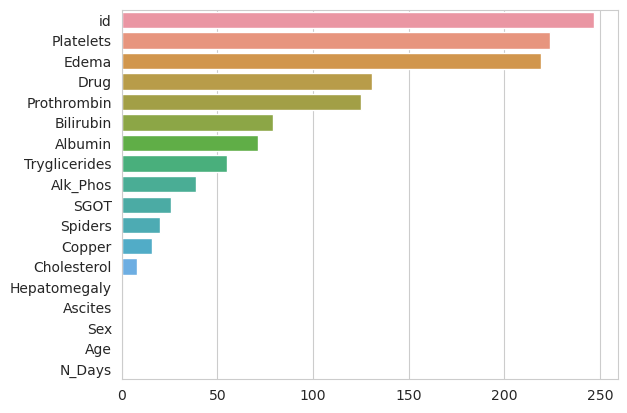

In [40]:
def plot_feat_importance(model):
    model.feature_importances_ 
    indices = np.argsort(model.feature_importances_)[::-1] 
    g = sns.barplot(y=train.columns[indices],x = model.feature_importances_[indices] , orient='h')
    
plot_feat_importance(model_lgbm)

<Axes: >

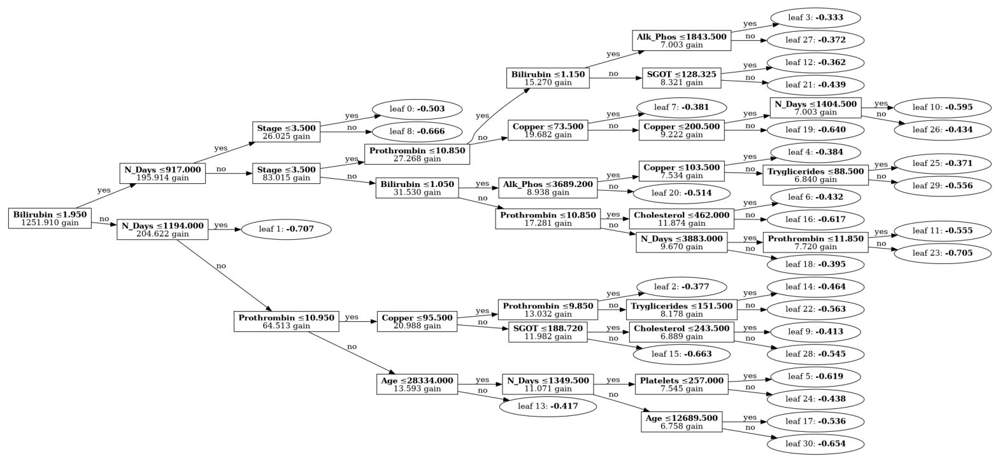

In [60]:
lgb.plot_tree(model_lgbm, figsize=(20, 20), show_info=['split_gain'])

In [61]:
lgbm_results_df = pd.DataFrame(lgbm_results,columns=['estimators','learning_rate','max_depth','cv_score','std_dev'])
lgbm_results_df.head()

,estimators,learning_rate,max_depth,cv_score,std_dev
0,100,0.05,3,0.461218,0.004895
1,100,0.05,4,0.451428,0.004314
2,100,0.05,5,0.448502,0.005272
3,100,0.05,6,0.445256,0.006454
4,100,0.05,7,0.445077,0.006505


In [62]:
# min value of lgbm results
lgbm_results_df[lgbm_results_df.cv_score == min(lgbm_results_df.cv_score)]

,estimators,learning_rate,max_depth,cv_score,std_dev
35,200,0.1,3,0.440167,0.004773


In [63]:
# min std of lgbm results
lgbm_results_df[lgbm_results_df.std_dev == min(lgbm_results_df.std_dev)]

,estimators,learning_rate,max_depth,cv_score,std_dev
56,300,0.075,4,0.446902,0.00277


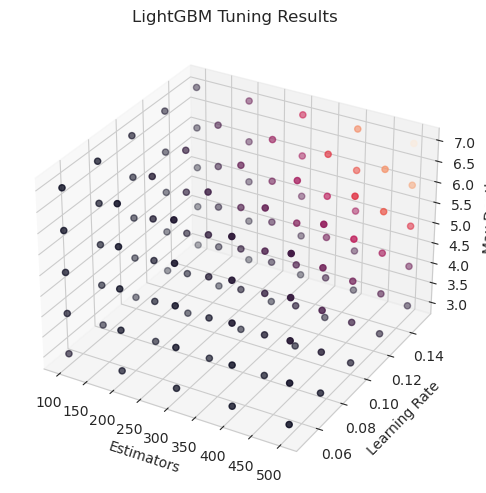

In [66]:
# make a 3d plot in matplotlib with x = estimators, y = learning_rate, z = max_depth, color = cv_score
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(5,5),tight_layout=True)
ax = fig.add_subplot(111, projection='3d')
ax.scatter(lgbm_results_df.estimators, lgbm_results_df.learning_rate, lgbm_results_df.max_depth, c=lgbm_results_df.cv_score, marker='o')
ax.set_xlabel('Estimators')
ax.set_ylabel('Learning Rate')
ax.set_zlabel('Max Depth')
plt.title('LightGBM Tuning Results')
plt.show()


In [37]:
lgbm_results_df.to_csv('24_01_01_lgbm_tuning.csv')

In [38]:
# model_lgbm.get_params()

## Extra Trees Classifier

In [39]:
# from sklearn.ensemble import ExtraTreesClassifier
# model_etc = ExtraTreesClassifier()

# preds_etc,scores_etc,oof_score_etc,oof_etc = run_cv_and_predict(train,test,features,model_etc,config.seed,verbose=True)

# default: .58540, stdev = .06140



## Support Vector Machines

In [40]:
# from sklearn.svm import SVC, LinearSVC
# model_svm = SVC(kernel='rbf', random_state = 12, probability=True)

# preds_svm,scores_svm,oof_score_svm,oof_svm = run_cv_and_predict(train,test,features,model_svm,config.seed,verbose=True)
# # need to add (probability=True) if want to use proba

# default: .66546, stdev: .00546

## KNN

In [41]:
# from sklearn.neighbors import KNeighborsClassifier

# model_knn = KNeighborsClassifier(n_neighbors=9, leaf_size=20)

# preds_knn,scores_knn,oof_score_knn,oof_knn = run_cv_and_predict(train,test,features,model_knn,config.seed,verbose=True)

# default: 2.12192, stdev = .17191


## Catboost

In [42]:
from catboost import CatBoostClassifier, Pool

it = 3000
lr = .1
d = 3

results = []

for it in [100,200,300,400,500]:
    for lr in [.05,.075, .1,.15]:
        for d in [3,4,5,6]:
            
            model_cat = CatBoostClassifier(iterations=it,
                                           learning_rate=lr,
                                           depth=d,
                                           loss_function='MultiClass',
                                           verbose=False,
                                           #cat_features=cat_feats
                                          )
            print(f'Iterations: {it}, learning rate: {lr}, depth: {d}')
            preds_cat,scores_cat,oof_score_cat,oof_cat = run_cv_and_predict(train,test,features,model_cat,config.seed,verbose=False)
            results.append([it,lr,d,np.mean(scores_cat), np.std(scores_cat)])

# default Log Loss score: 0.46336, Stdev: 0.01399, OOF score: 0.46336, lb = .41677
# it,lr,d = 500,.1,6, Log Loss score: 0.45240, Stdev: 0.01482, lb = .41780
# it,lr,d = 300,.1,6,Log Loss score: 0.44787, Stdev: 0.01597, lb = .42401
# it,lr,d = 200,.1,6, .449xx

# first optimization, min = 1500,.05,3,  Log Loss score: 0.44312, Stdev: 0.01499, lb = .42187
# low std: 1500,.1,3, score = .44602, stdev = .01288, lb = .41453

# changed to ohe, but used orig tuning
# 2000,.05,3, log loss = .44304, stdev = .01437, lb = .41670
# 3000, .1, 3, Log Loss score: 0.45858, Stdev: 0.01179, lb = .40857 (starting to look like minimizing std is better than minimizing cv)

# new after bools, etc. 3000,.1,3: Log Loss score: 0.46201, Stdev: 0.01266, 
# std scaling: Log Loss score: 0.46200, Stdev: 0.01267 (same)
# log transform, same hp's, Log Loss score: 0.46199, Stdev: 0.01265,

# with orig data: Log Loss score: 0.45122, Stdev: 0.00642, lb = .41317
# with orig data, 3000,.1,3, but all rows removed instead of imputing, Log Loss score: 0.44848, Stdev: 0.00375, lb = .41068

Iterations: 100, learning rate: 0.05, depth: 3
Log Loss score: 0.49212, Stdev: 0.00391, OOF score: 0.49212
Iterations: 100, learning rate: 0.05, depth: 4
Log Loss score: 0.48650, Stdev: 0.00388, OOF score: 0.48650
Iterations: 100, learning rate: 0.05, depth: 5
Log Loss score: 0.48133, Stdev: 0.00354, OOF score: 0.48133
Iterations: 100, learning rate: 0.05, depth: 6
Log Loss score: 0.47691, Stdev: 0.00488, OOF score: 0.47691
Iterations: 100, learning rate: 0.075, depth: 3
Log Loss score: 0.48072, Stdev: 0.00411, OOF score: 0.48072
Iterations: 100, learning rate: 0.075, depth: 4
Log Loss score: 0.47546, Stdev: 0.00367, OOF score: 0.47546
Iterations: 100, learning rate: 0.075, depth: 5
Log Loss score: 0.46922, Stdev: 0.00451, OOF score: 0.46922
Iterations: 100, learning rate: 0.075, depth: 6
Log Loss score: 0.46562, Stdev: 0.00421, OOF score: 0.46562
Iterations: 100, learning rate: 0.1, depth: 3
Log Loss score: 0.47466, Stdev: 0.00437, OOF score: 0.47466
Iterations: 100, learning rate: 0.

In [45]:
len(results)

80

In [47]:
if len(results)>0:
    cat_results = pd.DataFrame(results,columns=['estimators','learning_rate','max_depth','cv_score','std_dev'])
    print(cat_results.head())

   estimators  learning_rate  max_depth  cv_score   std_dev
0         100          0.050          3  0.492118  0.003909
1         100          0.050          4  0.486501  0.003879
2         100          0.050          5  0.481330  0.003545
3         100          0.050          6  0.476906  0.004881
4         100          0.075          3  0.480716  0.004112


In [48]:
# min value of cat results
cat_results[cat_results.cv_score == min(cat_results.cv_score)]

,estimators,learning_rate,max_depth,cv_score,std_dev
58,400,0.1,5,0.440858,0.003507


In [49]:
# min std of cat results
cat_results[cat_results.std_dev == min(cat_results.std_dev)]

,estimators,learning_rate,max_depth,cv_score,std_dev
79,500,0.15,6,0.454444,0.00159


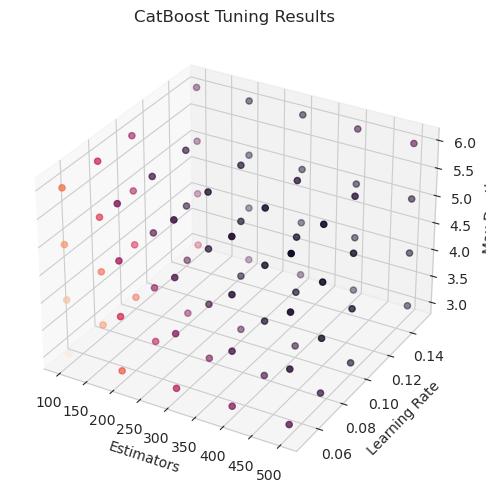

In [67]:
# draw a 3d plot of the results in matplotlib with x = estimators, y = learning_rate, z = max_depth, color = cv_score
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(5,5),tight_layout=True)
ax = fig.add_subplot(111, projection='3d')
ax.scatter(cat_results.estimators, cat_results.learning_rate, cat_results.max_depth, c=cat_results.cv_score, marker='o')
ax.set_xlabel('Estimators')
ax.set_ylabel('Learning Rate')
ax.set_zlabel('Max Depth')
plt.title('CatBoost Tuning Results')
plt.show()

# add a colorbar legend


In [51]:
# import plotly.express as px
# 
# if len(cat_results) > 0:
#     fig = px.scatter_3d(cat_results, x='estimators', y='learning_rate', z='max_depth',color='cv_score')  # scatter of 3 cols of df
#     fig.update_traces(marker={'size': 3})
#     fig.show(renderer='notebook')

## XGBoost

In [68]:
from xgboost import XGBClassifier

xgb_results = []
for est in [100,200,300,400, 500]:
    for lr in [.025,.05,.075,.1,.15]:
        for d in [3,4,5,6,7]:
            model_xgb = XGBClassifier(max_depth= d, 
                                      n_estimators= est, 
                                      learning_rate=lr,
                                      random_state=config.seed,  
                                      )
            print(f'est: {est},lr:{lr},d:{d}')
            preds_xgb,scores_xgb,oof_score_xgb,oof_xgb = run_cv_and_predict(train,test,features,model_xgb,config.seed,verbose=False)
            xgb_results.append([est,lr,d,np.mean(scores_xgb),np.std(scores_xgb)])
           
            
# default: .49xxx
# doesn't seem to vary when change random seed, does xgb not use that?
# 125,.03,8 = .46104, stdev = .00420, lb = .43723


est: 100,lr:0.025,d:3
Log Loss score: 0.52815, Stdev: 0.00452, OOF score: 0.52815
est: 100,lr:0.025,d:4
Log Loss score: 0.51486, Stdev: 0.00481, OOF score: 0.51486
est: 100,lr:0.025,d:5
Log Loss score: 0.50578, Stdev: 0.00451, OOF score: 0.50578
est: 100,lr:0.025,d:6
Log Loss score: 0.49709, Stdev: 0.00528, OOF score: 0.49709
est: 100,lr:0.025,d:7
Log Loss score: 0.49102, Stdev: 0.00524, OOF score: 0.49102
est: 100,lr:0.05,d:3
Log Loss score: 0.47623, Stdev: 0.00358, OOF score: 0.47623
est: 100,lr:0.05,d:4
Log Loss score: 0.46408, Stdev: 0.00295, OOF score: 0.46408
est: 100,lr:0.05,d:5
Log Loss score: 0.45782, Stdev: 0.00333, OOF score: 0.45782
est: 100,lr:0.05,d:6
Log Loss score: 0.45281, Stdev: 0.00398, OOF score: 0.45281
est: 100,lr:0.05,d:7
Log Loss score: 0.45076, Stdev: 0.00470, OOF score: 0.45076
est: 100,lr:0.075,d:3
Log Loss score: 0.46034, Stdev: 0.00376, OOF score: 0.46034
est: 100,lr:0.075,d:4
Log Loss score: 0.45017, Stdev: 0.00315, OOF score: 0.45017
est: 100,lr:0.075,d:5

In [73]:
if len(xgb_results)>0:
    xgb_results = pd.DataFrame(xgb_results,columns=['estimators','learning_rate','max_depth','cv_score','std_dev'])
    print(xgb_results.head())

   estimators  learning_rate  max_depth  cv_score   std_dev
0         100          0.025          3  0.528147  0.004520
1         100          0.025          4  0.514861  0.004810
2         100          0.025          5  0.505782  0.004505
3         100          0.025          6  0.497094  0.005275
4         100          0.025          7  0.491017  0.005241


In [74]:
# min value of xgb results
xgb_results[xgb_results.cv_score == min(xgb_results.cv_score)]

,estimators,learning_rate,max_depth,cv_score,std_dev
65,300,0.1,3,0.437564,0.004687


In [75]:
# min std of xgb results   
xgb_results[xgb_results.std_dev == min(xgb_results.std_dev)]

,estimators,learning_rate,max_depth,cv_score,std_dev
6,100,0.05,4,0.464078,0.002953


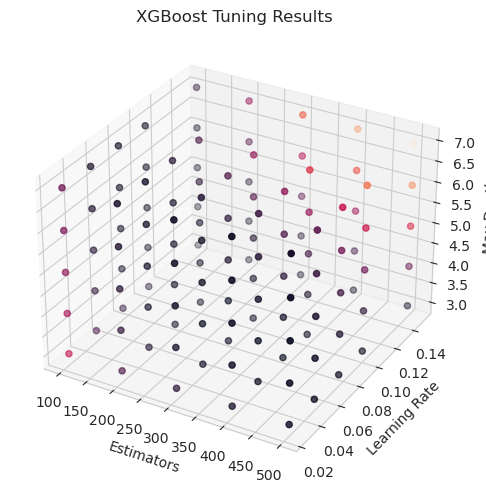

In [76]:
# plot results in matplotlib with x = estimators, y = learning_rate, z = max_depth, color = cv_score
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
    
fig = plt.figure(figsize=(5,5),tight_layout=True)
ax = fig.add_subplot(111, projection='3d')
ax.scatter(xgb_results.estimators, xgb_results.learning_rate, xgb_results.max_depth, c=xgb_results.cv_score, marker='o')
ax.set_xlabel('Estimators')
ax.set_ylabel('Learning Rate')
ax.set_zlabel('Max Depth')
plt.title('XGBoost Tuning Results')
plt.show()


### Plot results of hp grid

# Select Model

In [47]:
preds = np.mean(preds_lgbm,axis=1)
preds.shape

(5271, 3)

# Submission

In [48]:
ss.Status_C = preds[:,0]
ss.Status_CL = preds[:,1]
ss.Status_D = preds[:,2]
ss.head()

,id,Status_C,Status_CL,Status_D
0,7905,0.743866,0.025744,0.230389
1,7906,0.595211,0.264593,0.140196
2,7907,0.023074,0.012742,0.964183
3,7908,0.940861,0.005281,0.053857
4,7909,0.835524,0.019785,0.144691


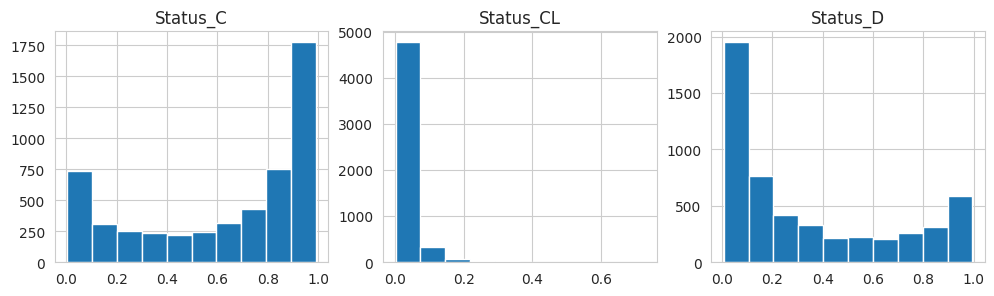

In [49]:
plt.figure(figsize=(12,3))
labels = ['Status_C', 'Status_CL', 'Status_D']
for i in [1,2,3]:
    plt.subplot(1,3,i)
    plt.hist(preds[:,i-1])
    plt.title(labels[i-1])

In [50]:
ss.to_csv('submission.csv',index=False)